### Look at deep cell density over time

In [1]:
import os
import pandas as pd
import numpy as np
from src.utilities.shape_utils import plot_mesh
from scipy.spatial import KDTree
import plotly.express as px
import trimesh
# # Load test dataset that used Kikume NLS marker
# root = "E:\\Nick\\Cole Trapnell's Lab Dropbox\\Nick Lammers\\Nick\\killi_tracker\\"
# experiment_date = "20240611_NLS-Kikume_24hpf_side2"
# config_name = "tracking_jordao_20240918.txt"
# model ="LCP-Multiset-v1"
# tracking_folder = config_name.replace(".txt", "")
# tracking_folder = tracking_folder.replace(".toml", "")

# well_num = 0
# start_i = 0
# stop_i = 1600

# suffix = ""

# # get path to metadata
# metadata_path = os.path.join(root, "metadata", "tracking")

# # set output path for tracking results
# project_path = os.path.join(root, "tracking", experiment_date,  tracking_folder, f"well{well_num:04}" + suffix, "")
# project_sub_path = os.path.join(project_path, f"track_{start_i:04}" + f"_{stop_i:04}" + suffix, "")

# load the tracks 
# tracks_df = pd.read_csv(os.path.join(project_sub_path, "tracks01.csv"))
# tracks_df.head()

tracks_df = pd.read_csv("/Users/nick/Cole Trapnell's Lab Dropbox/Nick Lammers/Nick/killi_temp/tracks01.csv")
tracks_df.head()

,track_id,t,z,y,x,id,parent_track_id,parent_id,volume,gmm_label,gmm0_prob,gmm1_prob,gmm_logL
0,1,0,5.0,58.0,441.0,1000001,-1,-1,3324.375,0.0,0.633889,0.366111,-2.073905
1,1,1,5.0,58.0,441.0,2000001,-1,1000001,3587.625,0.0,0.633889,0.366111,-2.073905
2,1,2,5.0,57.0,441.0,3000001,-1,2000001,3439.125,0.0,0.633889,0.366111,-2.073905
3,1,3,5.0,57.0,441.0,4000001,-1,3000001,3206.250,0.0,0.633889,0.366111,-2.073905
4,1,4,5.0,56.0,440.0,5000001,-1,4000001,3196.125,0.0,0.633889,0.366111,-2.073905


### First pass: use NN neighbor distances to estimate density

In [2]:
t = 1400
kn = 70
time_filter = (tracks_df["t"]<=t+5) & (tracks_df["t"]>=t-5)
tracks_df_t = tracks_df.loc[time_filter, :]
points = tracks_df_t.loc[:, ["x", "y", "z"]].to_numpy()

# Initialize the KDTree
tree = KDTree(points)
distances, indices = tree.query(points, k=kn)
dist_mean = np.mean(distances[:, 1:], axis=1)

# tracks_reflected = 
fig = px.scatter_3d(tracks_df_t, x="x", y="y", z="z", color=100*dist_mean**-2, range_color=[0, 0.5],)

fig.show()

### Can we do better?
The aggregate is clearly visible, but ideally we would query and plot density in a more principled way. One idea is to fit some sort of spherical mesh to the embryo

In [3]:
import plotly.graph_objects as go
from src.utilities.functions import sphereFit

# shift and normalize points to fit within a unit sphere
# pc = np.mean(points, axis=0)
# pc[2] = 0 # assume center lies on the xy plane 
# points_norm = points - pc
# radii = np.linalg.norm(points_norm, axis=1)
# points_norm = points_norm / np.max(radii)

# fit a sphere to the points
r, C = sphereFit(points[:, 0], points[:, 1], points[:, 2])
center = np.asarray(C[:3].ravel())

# initialize a mesh unit sphere
sphere_mesh_raw = trimesh.creation.icosphere(subdivisions=3, radius=1.0)

verts = np.asarray(sphere_mesh_raw.vertices.copy())
verts = verts * r
verts = verts + center[None, :]

sphere_mesh = sphere_mesh_raw.copy()
sphere_mesh.vertices = verts

fig, _, _ = plot_mesh(sphere_mesh)

fig.add_trace(go.Scatter3d(x=points[:, 0], y=points[:, 1], z=points[:, 2], mode="markers", marker=dict(size=3)))

fig.show()

In [8]:
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
import meshplot as mp

# Find the closest faces for each point
closest_points, distances, face_indices = sphere_mesh.nearest.on_surface(points)

# Count the number of points associated with each face
face_counts = np.bincount(face_indices, minlength=len(sphere_mesh.faces))

# Normalize face counts for color mapping
norm = Normalize(vmin=0, vmax=np.max(face_counts))
colormap = plt.cm.viridis  # Choose a colormap
face_colors = colormap(norm(face_counts))[:, :3]  # Get RGB colors

# Assign colors to the mesh faces
sphere_mesh.visual.face_colors = (face_colors * 255).astype(np.uint8)

# Initialize vertex intensity array
vertex_intensity = np.zeros(len(sphere_mesh.vertices))
vertex_counts = np.zeros(len(sphere_mesh.vertices))  # Track contributions per vertex

# Map face values to vertex intensity
for i, face in enumerate(sphere_mesh.faces):
    for vertex in face:
        vertex_intensity[vertex] += face_counts[i]  # Sum face values for each vertex
        vertex_counts[vertex] += 1  # Track how many times each vertex is used

# Average intensity per vertex
vertex_intensity /= vertex_counts

# Plot the mesh with colored faces
fig = go.Figure() 
_, lines, mesh = plot_mesh(sphere_mesh, surf_alpha=1)

mesh.intensity = vertex_intensity
fig.add_trace(mesh)
# fig.add_trace(lines)
fig.show()

In [7]:
vertex_counts

array([5., 5., 5., 5., 5., 5., 5., 5., 5., 5., 5., 5., 6., 6., 6., 6., 6.,
       6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6.,
       6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6.,
       6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6.,
       6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6.,
       6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6.,
       6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6.,
       6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6.,
       6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6.,
       6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6.,
       6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6.,
       6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6.,
       6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6., 6.,
       6., 6., 6., 6., 6.

In [6]:
import meshplot as mp

v, f = sphere_mesh.vertices.copy(), sphere_mesh.faces.copy()

mp.plot(v, f, face_counts)

Renderer(camera=PerspectiveCamera(children=(DirectionalLight(color='white', intensity=0.6, position=(429.75637…

In [37]:
np.mean(distances)

7.327527111142499

### Let's try this sketchy thing GhatGPT gave me

In [18]:
from scipy.special import sph_harm

def compute_sh_basis(theta, phi, l, m):
    # Compute spherical harmonic basis function for given l, m
    return sph_harm(m, l, phi, theta)  

def compute_sh_coefficients(points, max_l):
    theta, phi = cartesian_to_spherical(points)
    coefficients = {}
    for l in range(max_l + 1):
        for m in range(-l, l + 1):
            # Compute the coefficient for this (l, m)
            sh_values = compute_sh_basis(theta, phi, l, m)
            coefficients[(l, m)] = np.sum(sh_values) / len(points)
    return coefficients

def reconstruct_density(theta, phi, coefficients, max_l):
    density = 0
    for l in range(max_l + 1):
        for m in range(-l, l + 1):
            density += coefficients[(l, m)] * compute_sh_basis(theta, phi, l, m)
    return np.abs(density)

def cartesian_to_spherical(points):
    x, y, z = points.T
    r = np.sqrt(x**2 + y**2 + z**2)
    theta = np.arccos(z / r)  # Polar angle (0 to pi)
    phi = np.arctan2(y, x)    # Azimuthal angle (-pi to pi)
    return theta, phi

def spherical_to_cartesian(theta, phi, r=1.0):
    """
    Convert spherical coordinates to Cartesian coordinates.

    Parameters:
    - theta (array-like): Polar angle (in radians), 0 <= theta <= pi
    - phi (array-like): Azimuthal angle (in radians), -pi <= phi <= pi
    - r (array-like or scalar): Radius (default is 1.0 for unit sphere)

    Returns:
    - Cartesian coordinates as a tuple of arrays: (x, y, z)
    """
    theta = np.asarray(theta)
    phi = np.asarray(phi)
    r = np.asarray(r)

    # Cartesian coordinates
    x = r * np.sin(theta) * np.cos(phi)
    y = r * np.sin(theta) * np.sin(phi)
    z = r * np.cos(theta)

    return x, y, z

In [17]:
import numpy as np

# Generate random points on the unit sphere (for testing)
points_norm = points - center
points_norm /= np.linalg.norm(points_norm, axis=1, keepdims=True)

# Compute spherical harmonic coefficients
max_l = 5
coefficients = compute_sh_coefficients(points, max_l)

# Evaluate reconstructed density at arbitrary spherical coordinates
theta = np.linspace(0, np.pi, 50)  # Polar angles
phi = np.linspace(-np.pi, np.pi, 100)  # Azimuthal angles
density = reconstruct_density(theta[:, None], phi[None, :], coefficients, max_l)

In [26]:
# Create 2D grids for theta and phi
theta_grid, phi_grid = np.meshgrid(theta, phi, indexing='ij')

x, y, z = spherical_to_cartesian(theta_grid.ravel(), phi_grid.ravel(), r=1.0)

fig = px.scatter_3d(x=x, y=y, z=z, color=density.ravel(), range_color=[0, 0.2])
fig.show()

### well....that defintely looks...cool?

### Find closest face

In [32]:
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
import meshplot as mp

# Find the closest faces for each point
closest_points, distances, face_indices = sphere_mesh.nearest.on_surface(points)

# Count the number of points associated with each face
face_counts = np.bincount(face_indices, minlength=len(sphere_mesh.faces))

# Normalize face counts for color mapping
norm = Normalize(vmin=0, vmax=np.max(face_counts))
colormap = plt.cm.viridis  # Choose a colormap
face_colors = colormap(norm(face_counts))[:, :3]  # Get RGB colors

# Assign colors to the mesh faces
sphere_mesh.visual.face_colors = (face_colors * 255).astype(np.uint8)

# Plot the mesh with colored faces
fig = go.Figure() 
_, lines, mesh = plot_mesh(sphere_mesh, surf_alpha=1)

mesh.intensity = face_counts
fig.add_trace(mesh)
# fig.add_trace(lines)
fig.show()

In [38]:
from scipy.spatial import KDTree

t = 1000
kn = 10
tracks_df_t = tracks_df.loc[tracks_df["t"]==t, :]
points = tracks_df_t.loc[:, ["x", "y", "z"]].to_numpy()

# Initialize the KDTree
tree = KDTree(points)
distances, indices = tree.query(points, k=10)
dist_mean = np.mean(distances[:, 1:], axis=1)

# get normalized points
pc = np.mean(points, axis=0)

pc[2] = 0 # assume center lies on the xy plane 
points_norm = points - pc
radii = np.linalg.norm(points_norm, axis=1)
points_norm = points_norm / np.min(radii)

# find closest point on sphere for each point
sphere_points = np.c_[x_grid.ravel(), y_grid.ravel(), z_grid.ravel()]
tree_sphere = KDTree(sphere_points)
distances, indices = tree_sphere.query(points_norm, k=2)

sphere_ref = sphere_points[indices[:, 0], :]

In [39]:
# fig = go.Figure()
# fig.add_trace(go.Scatter3d(x=sphere_points[:, 0], y=sphere_points[:, 1], z=sphere_points[:, 2]))
# fig.add_trace(go.Scatter3d(x=sphere_ref[:, 0], y=sphere_ref[:, 1], z=sphere_ref[:, 2]))
# fig.show()

print(sphere_ref[:10, 1])
print(points_norm[:10, 1])
print(distances[:10])

[ 0.12447276  0.25438433  0.64523301  0.03638458 -0.18777491 -0.9628251
 -0.69317125 -0.83765751 -0.04029514  0.08294062]
[ 0.12597242  0.3000492   0.71515537  0.03893403 -0.205443   -1.07917454
 -0.71428282 -0.87831671 -0.0414091   0.07575796]
[[0.05133346 0.05438255]
 [0.07832245 0.08041158]
 [0.12801466 0.12859537]
 [0.0394554  0.04790681]
 [0.03239831 0.03948977]
 [0.12763714 0.12936357]
 [0.05568266 0.05732917]
 [0.05505247 0.05961489]
 [0.03490104 0.03670382]
 [0.05027709 0.05205747]]


In [40]:
values = dist_mean**-2
# Step 3: Interpolate values onto the grid
# interp_points = np.column_stack((x_grid.ravel(), y_grid.ravel(), z_grid.ravel()))
interpolated_values = griddata(points_norm, values, sphere_points, method='linear')
interpolated_values = interpolated_values.reshape(x_grid.shape)

# Plot the 3D surface in Plotly
fig = go.Figure()

fig.add_trace(go.Surface(
    x=x_grid, 
    y=y_grid, 
    z=z_grid, 
    surfacecolor=interpolated_values,  # Map scalar field to surface color
    colorscale="Viridis",
    colorbar=dict(title="Scalar Value"),
    showscale=True
))

fig.update_layout(
    title="Interpolated Scalar Field on a Hemisphere",
    scene=dict(
        xaxis_title="X",
        yaxis_title="Y",
        zaxis_title="Z",
        aspectmode="data"  # Ensures correct aspect ratio
    )
)

fig.show()

In [30]:
np.max(points_norm)

1.0425558414169398

### Filter for just the deep cells
This is approximate currently, but still gets rid of most of the EVL cells

In [2]:
tracks_df_v = tracks_df.copy()
tracks_df_v[["dx", "dy", "dz"]] = tracks_df_v.loc[:, ["track_id", "x", "y", "z"]].groupby(["track_id"]).diff()
tracks_df_v["v"] = np.sqrt(tracks_df_v["dx"]**2 + tracks_df_v["dy"]**2 + tracks_df_v["dz"]**2)
tracks_df_v = tracks_df_v.loc[:, ["track_id", "v"]].groupby(["track_id"]).mean().reset_index()

tracks_df = tracks_df.merge(tracks_df_v, how="left", on="track_id")

tracks_df.head()

,track_id,t,z,y,x,id,parent_track_id,parent_id,volume,gmm_label,gmm0_prob,gmm1_prob,gmm_logL,v
0,1,0,5.0,58.0,441.0,1000001,-1,-1,3324.375,0.0,0.633889,0.366111,-2.073905,0.812908
1,1,1,5.0,58.0,441.0,2000001,-1,1000001,3587.625,0.0,0.633889,0.366111,-2.073905,0.812908
2,1,2,5.0,57.0,441.0,3000001,-1,2000001,3439.125,0.0,0.633889,0.366111,-2.073905,0.812908
3,1,3,5.0,57.0,441.0,4000001,-1,3000001,3206.250,0.0,0.633889,0.366111,-2.073905,0.812908
4,1,4,5.0,56.0,440.0,5000001,-1,4000001,3196.125,0.0,0.633889,0.366111,-2.073905,0.812908


In [4]:
gmm_filter = tracks_df["gmm0_prob"] >= 0.5 # use probs from GMM
vel_filter0 = tracks_df["v"] >= 2 # add fast-but-large nuclei. In practice most of these look like deep cells
vel_filter1 = tracks_df["v"] <= 0.2 # remove these

deep_filter = (gmm_filter | vel_filter0) & (~vel_filter1)

deep_tracks_df = tracks_df.loc[deep_filter, :].copy()
deep_tracks_df.shape

(468829, 14)

## Look at initial positions of deep cells

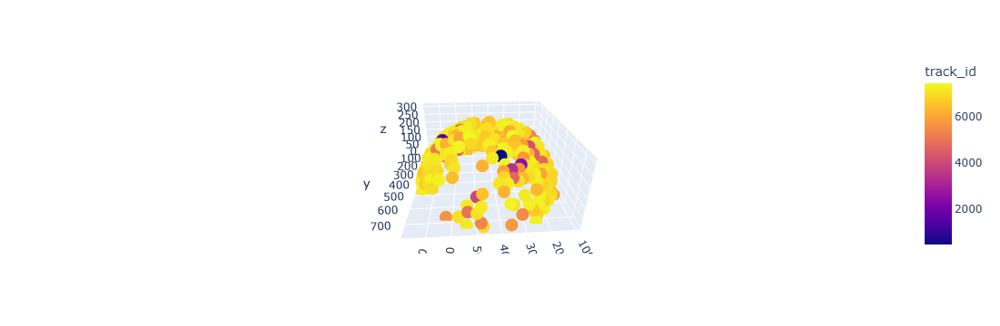

In [12]:
import plotly.express as px
t_max = 900

fig = px.scatter_3d(deep_tracks_df.loc[deep_tracks_df["t"]==t_max, :], x="x", y="y", z="z", color="track_id")
fig.show()

In [15]:
np.mean(deep_tracks_df.loc[deep_tracks_df["t"]==t_max, "parent_track_id"] > 0)

0.05

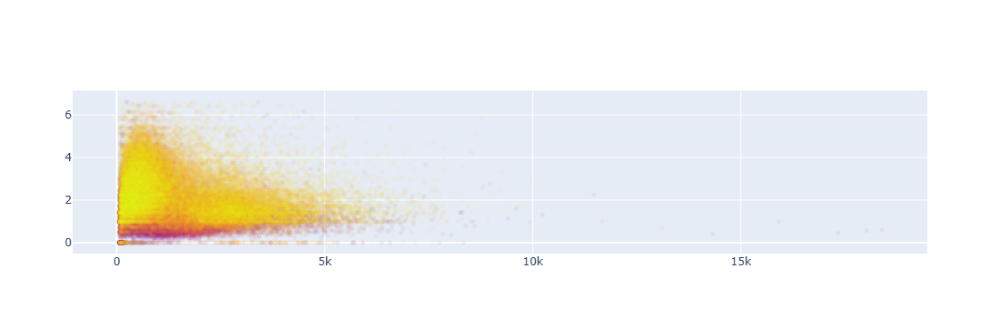

In [9]:
fig = go.Figure(go.Scatter(
        x = tracks_df_v["Volume"],
        y = tracks_df_v["v"],
        mode="markers",
        marker=dict(size=5, opacity=0.05, color=tracks_df_v["time_group"])
        # colorscale = 'Blues'
))

fig.show()

In [22]:
from sklearn.cluster import KMeans, dbscan
vv_array = tracks_df_v[["v", "Volume"]].to_numpy()
vv_array = vv_array - np.mean(vv_array, axis=0)
vv_array = np.divide(vv_array, np.percentile(np.abs(vv_array), 90, axis=0))

core, labels = dbscan(vv_array, eps=3,  min_samples = 25)

KeyboardInterrupt: 

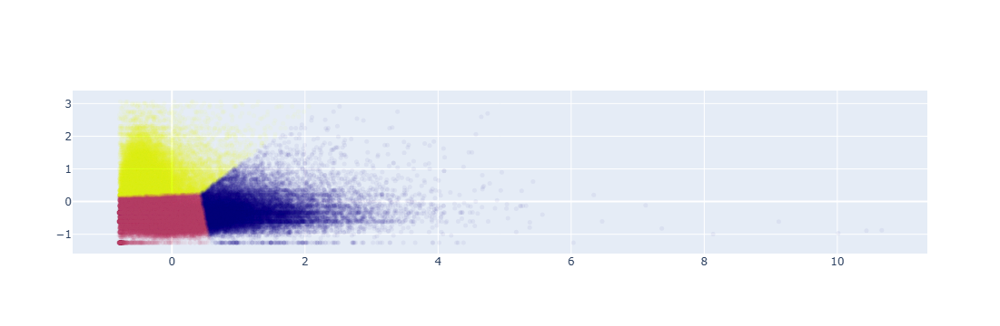

In [21]:
fig = go.Figure(go.Scatter(
        x = vv_array[:, 1],
        y = vv_array[:, 0],
        mode="markers",
        marker=dict(size=5, opacity=0.05, color=labels)
        # colorscale = 'Blues'
))

fig.show()

In [18]:
vv_array

array([[-0.26215979, -0.01855563],
       [-0.23075368, -0.02337266],
       [-0.15304615, -0.03993427],
       ...,
       [ 0.01544232,  0.05679725],
       [ 0.06560636, -0.02674361],
       [ 0.11095812, -0.06438097]])